In [1]:
import os
import argparse
import warnings
warnings.simplefilter(action='ignore', category=DeprecationWarning) # pandas warning pyarrow
import pandas as pd
import numpy as np
from numpy.matlib import repmat
from scipy.stats import wasserstein_distance, spearmanr, multinomial, ttest_1samp
from utils import *
import matplotlib.pyplot as plt
import matplotlib as mpl
from cycler import cycler
from sklearn import linear_model
import statsmodels.api as sm
from statsmodels.formula.api import ols
import pylab

# Directories
proj_dir = "/home/wcp27/project/halluc_prog_MAPnet"
result_dir = "/".join([proj_dir, "results", "SRP"])
if not os.path.isdir(result_dir):
    os.makedirs(result_dir)

In [2]:
# Model types
## Number of iterations
count = 5
mod = range(count)

## Distortions and values
cl_mdl = ["CL00050"]
bl_mdl = ["BL00200", "BL01500", "BL02600"]
no_mdl = ["NO00060", "NO00110", "NO00200"]
co_mdl = ["CO04000", "CO18000", "CO70000"]
ce_mdl = ["CE01500", "CE04000", "CE62000"]
ed_mdl = ["ED01500", "ED04000", "ED12000"]
cx_mdl = ["CX01400", "CX01800", "CX02700"]
mi_mdl = ["MI01500", "MI04000", "MI14000"]
store_dist = [cl_mdl, bl_mdl, no_mdl, co_mdl, ce_mdl, ed_mdl, cx_mdl, mi_mdl]

## Other variations
expects = ["A0", "A1"]
lrs = ["00", "10"]
itrs = ["A", "B", "C", "D", "E"]
type_dist = ["CL", "BL", "NO", "CO", "CE", "ED", "CX", "MI"]
intensities = ["Low", "Moderate", "High"]

In [3]:
# HALLUCINATION RATE ANALYSIS
halluc_rate_dir = "/".join([result_dir, "halluc_rate"])
if not os.path.isdir(halluc_rate_dir):
    os.makedirs(halluc_rate_dir)

In [4]:
# Instantiate loop variables
dict_halluc = {"Model": [], "Intensity": [], "TimePoint": [], "A": [], "B": [], "C": [], "D": [], "E": []}

# Gather hallucination rates
for mdl_lst in store_dist: # Distortion types
    for j, dist in enumerate(mdl_lst):
        for lr in lrs: # Learning rate types
            for expect in expects: # Expectation type
                # Full model name
                mdl = "_".join([expect, dist, lr])
    
                # Model time points
                models = ["_".join([mdl, str(i)]) for i in mod]
    
                for model in models: # Go through time points
                    # Store model
                    dict_halluc["Model"].append(mdl)
                    dict_halluc["TimePoint"].append(int(model.split("_")[-1]))
                    if "CL00050" in mdl_lst[0]:
                        dict_halluc["Intensity"].append("None")
                    elif j == 0:
                        dict_halluc["Intensity"].append("Low")
                    elif j == 1:
                        dict_halluc["Intensity"].append("Moderate")
                    elif j == 2:
                        dict_halluc["Intensity"].append("High")
                    for itr in itrs: # Different iterations
                        # Test type
                        test_type = mdl2dist(model)
                        
                        # Set data directory
                        data_dir = "/".join([proj_dir, "images", itr, model])

                        # Calculate hallucination rate
                        halluc_rate = calc_halluc_rate(model, test_type, data_dir, 6)

                        # Store hallucionation rate
                        dict_halluc[itr].append(halluc_rate)

In [5]:
# Create dataframe from dictionary
df_halluc = pd.DataFrame(dict_halluc)
tmp_models = df_halluc["Model"].values
df_halluc["Expectation"] = [bool(int(i.split("_")[0][1])) for i in tmp_models]
df_halluc["Distortion"] = [i.split("_")[1][0:2] for i in tmp_models]
df_halluc["Value"] = [round(int(i.split("_")[1][2:])*0.001, 2) for i in tmp_models]
df_halluc["LearnRate"] = [0.0001 if i.split("_")[2] == '00' else 0.001 for i in tmp_models]

# Reorder
df_halluc = df_halluc[["Model", "Expectation", "Distortion", "Value", "Intensity", "LearnRate", "TimePoint", "A", "B", "C", "D", "E"]]

# Save to CSV
df_halluc.to_csv("/".join([halluc_rate_dir, "halluc_rate.csv"]), index=False)

In [6]:
fig_hr, axs = plt.subplots(8, 12, figsize=(180, 80))
#plt.legend(itrs+["Polynomial", "Average"], bbox_to_anchor=(1.05, 1.0), loc="upper left")
for i, mdl_lst in enumerate(store_dist): # Distortion types
    j = 0
    if "CL00050" in mdl_lst[0]:
        mdl_lst = mdl_lst*len(store_dist[1])
    for dist in mdl_lst:
        for lr in lrs: # Learning rate types
            for expect in expects: # Expectation type
                # Full model name
                mdl = "_".join([expect, dist, lr])

                # Extract data
                df_tmp = df_halluc[df_halluc["Model"]==mdl]
                
                # Create arrays
                itr_halluc_rate = df_tmp[itrs].values
                itr_time = repmat(df_tmp["TimePoint"].values, len(itrs), 1)

                # Calculate average trace
                avg_halluc_rate = np.mean(itr_halluc_rate, 1)
                sd_halluc_rate = np.std(itr_halluc_rate, 1)
                
                # Fit polynomial
                z = np.polyfit(np.array([0, 1, 2, 3, 4]), avg_halluc_rate, 4)
                p = np.poly1d(z)
                hr_pred = p(np.linspace(0, 4, num=100))
                
                # Plot results
                axs[i, j].plot(itr_halluc_rate, alpha=0.4, linewidth=4)
                #axs[i, j].plot(np.linspace(0, 4, num=100), hr_pred, linewidth=4, color="grey")
                axs[i, j].errorbar(itr_time[0], avg_halluc_rate, yerr=sd_halluc_rate, linewidth=4, color="black")
                axs[i, j].set_xticks([i for i in range(count)])
                axs[i, j].set_title(mdl, fontsize=30)
                axs[i, j].set_ylim([-0.01, 0.2])
                if i == 7:
                    axs[i, j].set_xticklabels(mod)
                    axs[i, j].set_xlabel("Time", fontsize=25)
                else:
                    axs[i, j].set_xticklabels([])
                if j == 0:
                    axs[i, j].set_ylabel("Hallucination Rate", fontsize=25)
                else:
                    axs[i, j].set_yticklabels([])
                axs[i, j].legend(itrs+["Polynomial", "Average"], bbox_to_anchor=(1.05, 1.0), loc="upper left")
                # Update index
                j += 1
# Save figure
plt.savefig("/".join([halluc_rate_dir, "halluc_rate_all.png"]), bbox_inches='tight')

In [7]:
# SPECIFIC HALLUCINATION RATE ANALYSIS
spec_halluc_rate_dir = "/".join([result_dir, "spec_halluc_rate"])
if not os.path.isdir(spec_halluc_rate_dir):
    os.makedirs(spec_halluc_rate_dir)

In [8]:
# Instantiate loop variables
dict_spec_halluc = {"Model": [], "Intensity": [], "TimePoint": [], "A": [], "B": [], "C": [], "D": [], "E": []}

# Gather hallucination rates
for mdl_lst in store_dist: # Distortion types
    for j, dist in enumerate(mdl_lst):
        for lr in lrs: # Learning rate types
            for expect in expects: # Expectation type
                # Full model name
                mdl = "_".join([expect, dist, lr])
    
                # Model time points
                models = ["_".join([mdl, str(i)]) for i in mod]
    
                for model in models: # Go through time points
                    # Store model
                    dict_spec_halluc["Model"].append(mdl)
                    dict_spec_halluc["TimePoint"].append(int(model.split("_")[-1]))
                    if "CL00050" in mdl_lst[0]:
                        dict_spec_halluc["Intensity"].append("None")
                    elif j == 0:
                        dict_spec_halluc["Intensity"].append("Low")
                    elif j == 1:
                        dict_spec_halluc["Intensity"].append("Moderate")
                    elif j == 2:
                        dict_spec_halluc["Intensity"].append("High")
                    for itr in itrs: # Different iterations
                        # Test type
                        test_type = mdl2dist(model)
                        
                        # Set data directory
                        data_dir = "/".join([proj_dir, "images", itr, model])

                        # Calculate hallucination rate
                        spec_halluc_rate = calc_spec_halluc_rate(model, test_type, data_dir, 6)

                        # Store hallucionation rate
                        dict_spec_halluc[itr].append(spec_halluc_rate)

In [51]:
# Create dataframe from dictionary
df_spec_halluc = pd.DataFrame(dict_spec_halluc)

# Generate additional columns
tmp_models = df_spec_halluc["Model"].values
df_spec_halluc["Expectation"] = [bool(int(i.split("_")[0][1])) for i in tmp_models]
df_spec_halluc["Distortion"] = [i.split("_")[1][0:2] for i in tmp_models]
df_spec_halluc["Value"] = [round(int(i.split("_")[1][2:])*0.001, 2) for i in tmp_models]
df_spec_halluc["LearnRate"] = [0.0001 if i.split("_")[2] == '00' else 0.001 for i in tmp_models]

# Reorder
df_spec_halluc = df_spec_halluc[["Model", "Expectation", "Distortion", "Value", "Intensity", "LearnRate", "TimePoint", "A", "B", "C", "D", "E"]]

# Save to CSV
df_spec_halluc.to_csv("/".join([spec_halluc_rate_dir, "spec_halluc_rate.csv"]), index=False)

In [10]:
fig_spec, axs = plt.subplots(8, 12, figsize=(180, 80))
colors = ["#1b9e77", "#d95f02", "#7570b3", "#e7298a", "#66a61e"]
#plt.legend(itrs+["Average"], bbox_to_anchor=(1.05, 1.0), loc="upper left")
for i, mdl_lst in enumerate(store_dist): # Distortion types
    j = 0
    if "CL00050" in mdl_lst[0]:
        mdl_lst = mdl_lst*len(store_dist[1])
    for dist in mdl_lst:
        for lr in lrs: # Learning rate types
            for expect in expects: # Expectation type
                # Full model name
                mdl = "_".join([expect, dist, lr])

                # Extract data
                df_tmp = df_spec_halluc[df_spec_halluc["Model"]==mdl]
                
                # Create arrays
                itr_halluc_rate = df_tmp[itrs].values
                itr_time = repmat(df_tmp["TimePoint"].values, len(itrs), 1)

                # Calculate average trace
                avg_halluc_rate = np.mean(itr_halluc_rate, 1)
                sd_halluc_rate = np.std(itr_halluc_rate, 1)
                
                # Fit polynomial
                #z = np.polyfit(np.array([0, 1, 2, 3, 4]), avg_halluc_rate, 4)
                #p = np.poly1d(z)
                #hr_pred = p(np.linspace(0, 4, num=100))
                
                # Plot results
                for k in range(count):
                    axs[i, j].plot(itr_halluc_rate[:,k], alpha=0.4, linewidth=4, color=colors[k])
                #axs[i, j].plot(np.linspace(0, 4, num=100), hr_pred, linewidth=4, color="grey")
                axs[i, j].errorbar(itr_time[0], avg_halluc_rate, yerr=sd_halluc_rate, linewidth=4, color="black")
                axs[i, j].set_xticks([i for i in range(count)])
                axs[i, j].set_title(mdl, fontsize=30)
                axs[i, j].set_ylim([-0.01, 0.65])
                if i == 7:
                    axs[i, j].set_xticklabels(mod)
                    axs[i, j].set_xlabel("Time", fontsize=25)
                else:
                    axs[i, j].set_xticklabels([])
                if j == 0:
                    axs[i, j].set_ylabel("Hallucination Rate", fontsize=25)
                else:
                    axs[i, j].set_yticklabels([])
                axs[i, j].legend(itrs+["Average"], bbox_to_anchor=(1.05, 1.0), loc="upper left")
                # Update index
                j += 1
# Save figure
plt.savefig("/".join([spec_halluc_rate_dir, "spec_halluc_rate_all.png"]), bbox_inches='tight')

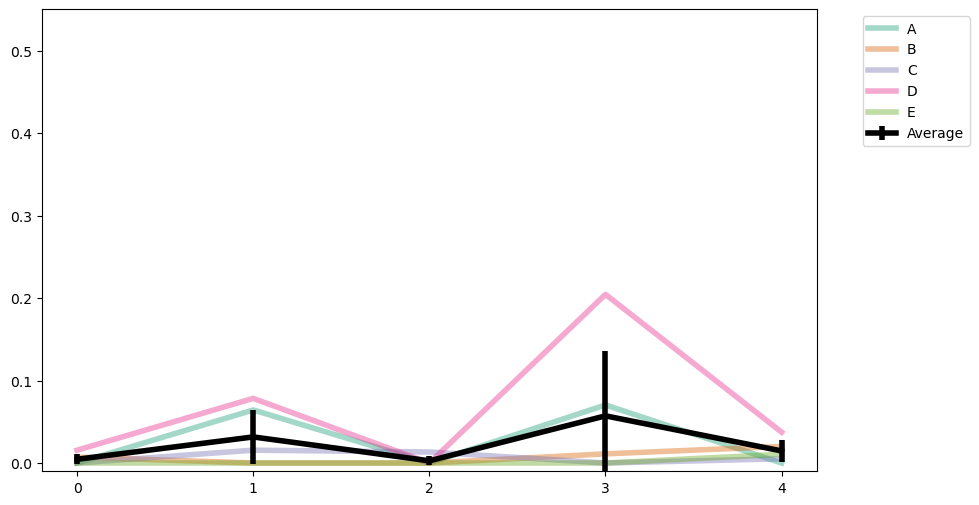

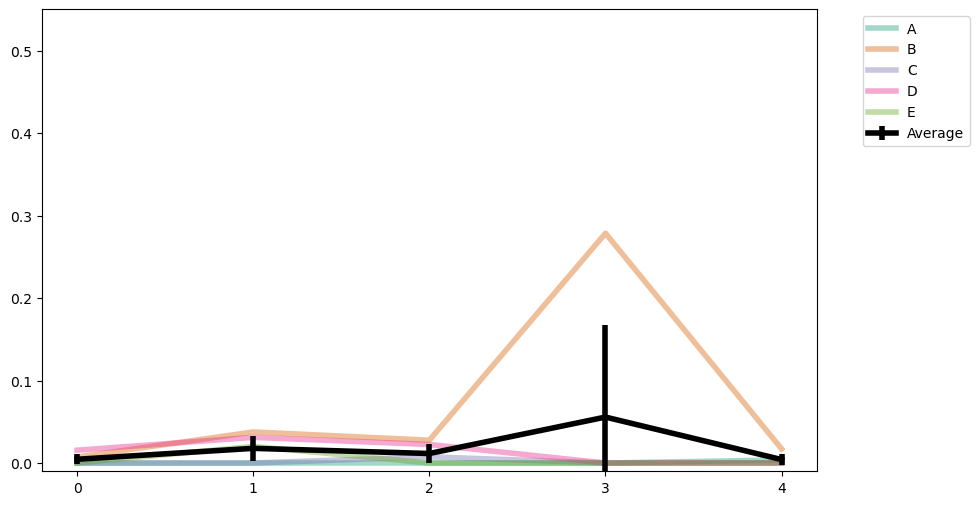

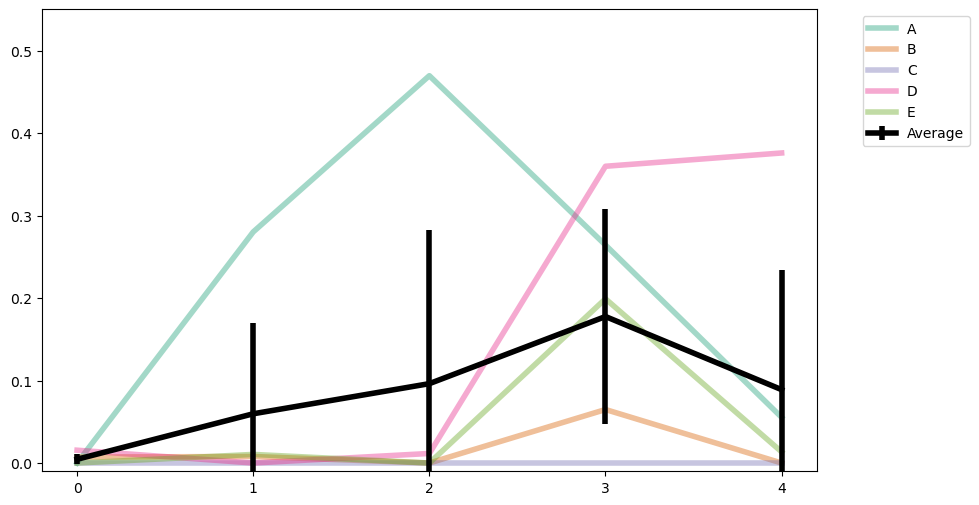

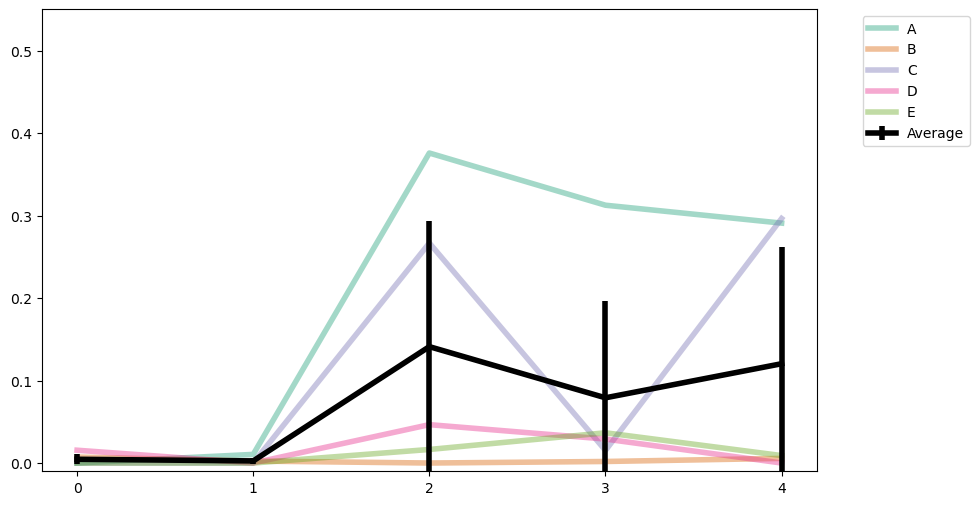

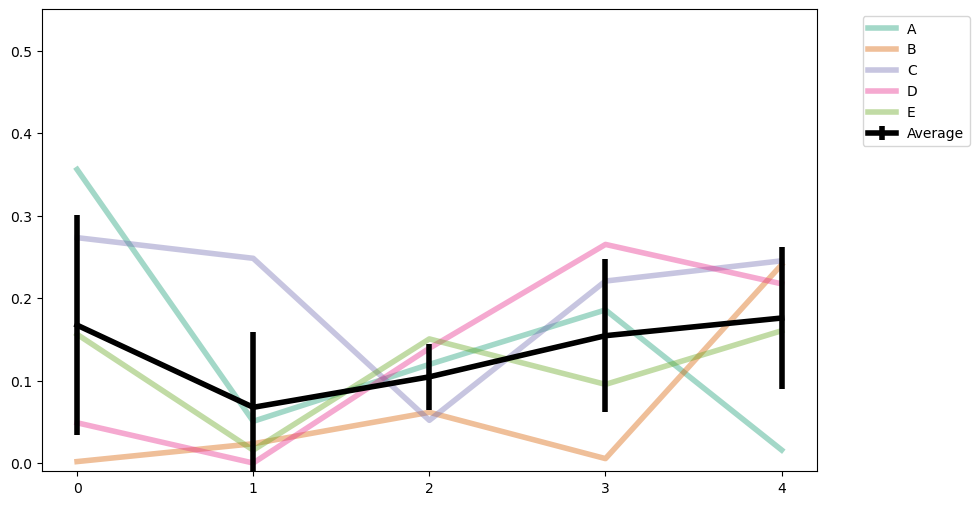

...

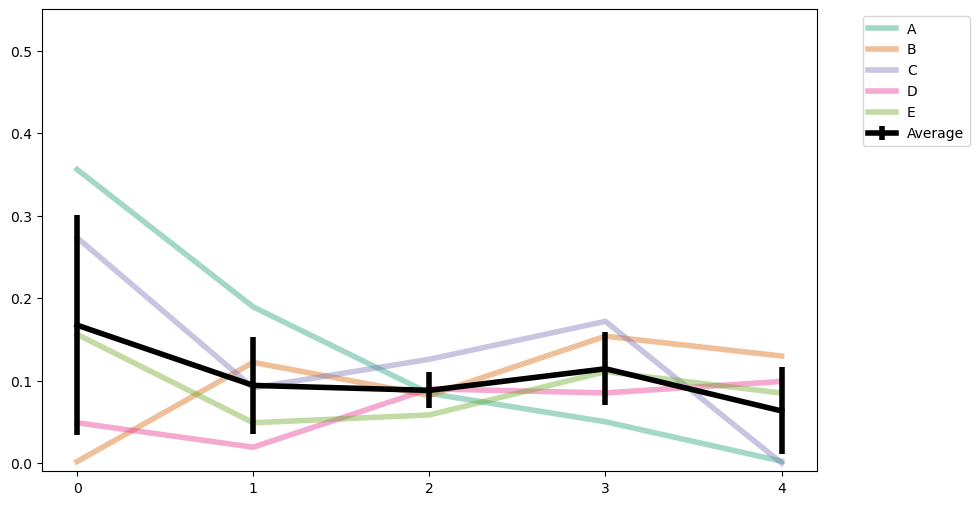

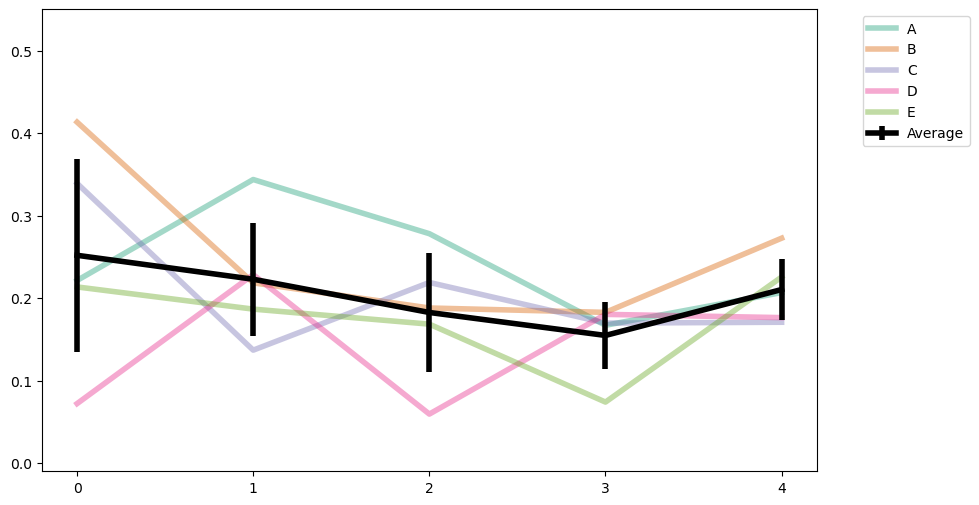

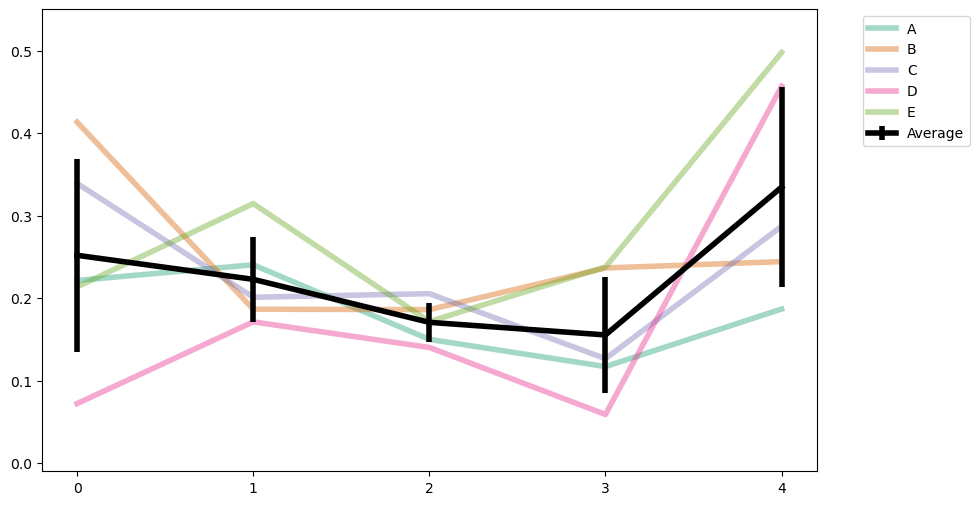

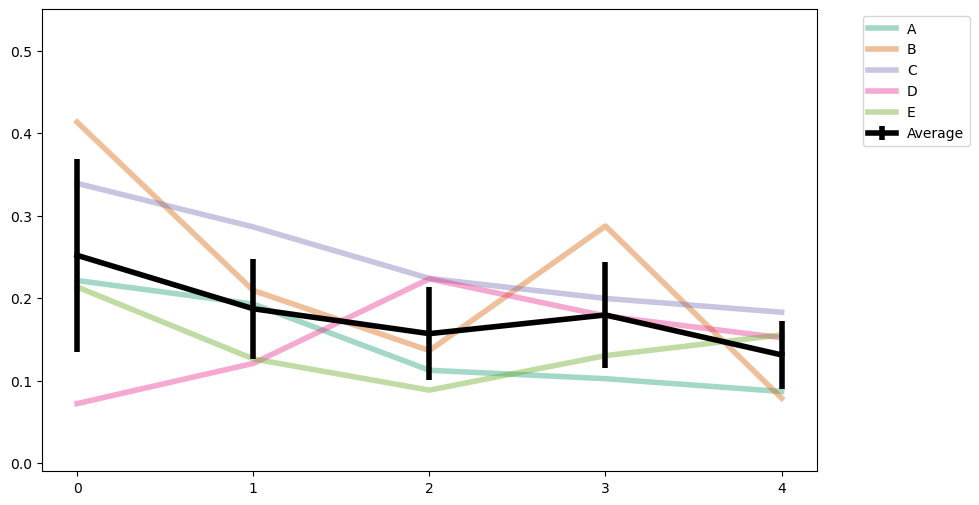

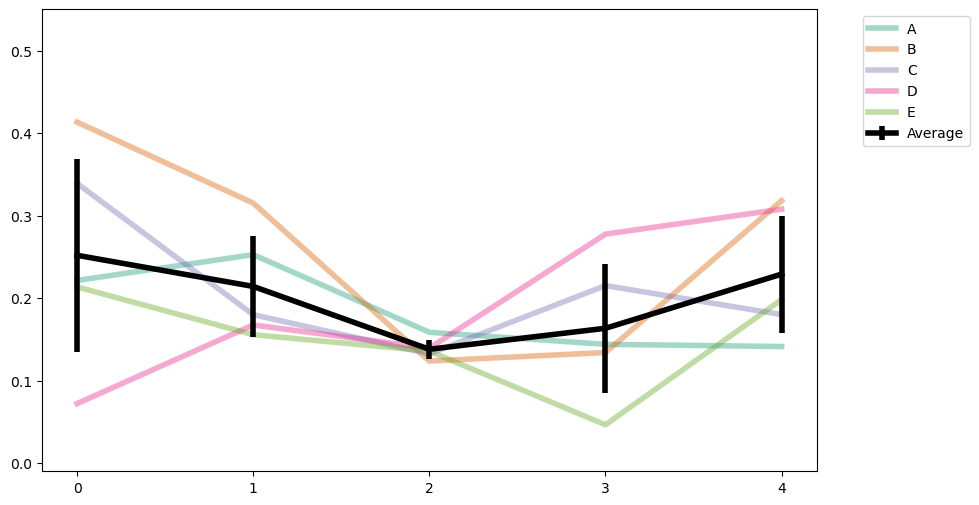

In [11]:
# For POSTER examples
colors = ["#1b9e77", "#d95f02", "#7570b3", "#e7298a", "#66a61e"]

for mdl in ["A0_MI01500_00", "A1_MI01500_00", "A0_MI01500_10", "A1_MI01500_10", 
            "A0_MI04000_00", "A1_MI04000_00", "A0_MI04000_10", "A1_MI04000_10", 
            "A0_MI14000_00", "A1_MI14000_00", "A0_MI14000_10", "A1_MI14000_10"]:
    # Filter dataframe
    df_tmp = df_spec_halluc[df_spec_halluc["Model"]==mdl]

    # Create arrays
    itr_halluc_rate = df_tmp[itrs].values
    itr_time = repmat(df_tmp["TimePoint"].values, len(itrs), 1)

    # Calculate average trace
    avg_halluc_rate = np.mean(itr_halluc_rate, 1)
    sd_halluc_rate = np.std(itr_halluc_rate, 1)
    
    fig_sample, axs = plt.subplots(figsize=(10, 6))
    # Plot results
    for k in range(count):
        axs.plot(itr_halluc_rate[:,k], alpha=0.4, linewidth=4, color=colors[k])

    axs.errorbar(itr_time[0], avg_halluc_rate, yerr=sd_halluc_rate, linewidth=4, color="black")
    axs.set_xticks([i for i in range(count)])
    axs.set_ylim([-0.01, 0.55])
    axs.legend(itrs+["Average"], bbox_to_anchor=(1.05, 1.0), loc="upper left")

    plt.savefig("/".join([spec_halluc_rate_dir, mdl+".png"]), bbox_inches='tight')

In [12]:
# SPECIFIC HALLUCINATION TIME ANALYSIS
spec_halluc_time_dir = "/".join([result_dir, "spec_halluc_time"])
if not os.path.isdir(spec_halluc_time_dir):
    os.makedirs(spec_halluc_time_dir)

In [13]:
# Extract unique models
df_spec_time = df_spec_halluc.iloc[0:df_spec_halluc.shape[0]:5,:].drop("TimePoint", axis=1).reset_index(drop=True)

for i, mdl in enumerate(df_spec_time["Model"].values):
    # Extract model data
    df_tmp = df_spec_halluc[df_spec_halluc["Model"] == mdl]

    for itr in itrs:
        # Extract iteration data
        itr_halluc_rate = df_tmp[itr].values
        itr_time = df_tmp["TimePoint"].values

        # Fit linear model
        tmp_lm = linear_model.LinearRegression().fit(itr_time.reshape(-1, 1), itr_halluc_rate.reshape(-1, 1)).coef_[0][0]

        # Save effect of time
        df_spec_time.at[i, itr] = tmp_lm

In [14]:
# Generate additional columns
df_spec_time["Mean"] = df_spec_time[itrs].mean(axis=1)
df_spec_time["SD"] = df_spec_time[itrs].std(axis=1)

# Save to CSV
df_spec_time.to_csv("/".join([spec_halluc_time_dir, "spec_halluc_time.csv"]), index=False)

In [15]:
# Plotting format
#mpl.rcParams['lines.linewidth'] = 16
mpl.rcParams['axes.prop_cycle'] = cycler(
    color=["#1b9e77", "#d95f02", "#7570b3", "#e7298a", "#66a61e", "#e6ab02", "#a6761d", "#666666"])

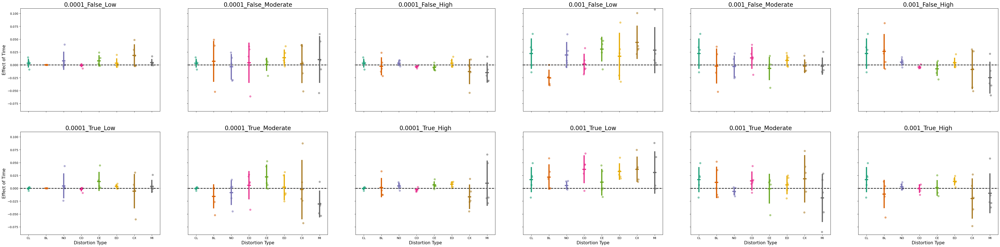

In [16]:
j=0
jitter = np.random.uniform(-0.1, 0.1, 5).reshape(1, -1)
fig_spec_time, axs = plt.subplots(2, 6, figsize=(60, 14))

for i, expect in enumerate([False, True]):
    j = 0
    for lr in [0.0001, 0.001]:
        for intense in intensities:
            # Filter data frame
            df_tmp = df_spec_time[(df_spec_time["Expectation"] == expect) & (df_spec_time["LearnRate"] == lr)]
            df_tmp = df_tmp[(df_tmp["Intensity"] == intense) | (df_tmp["Intensity"] == "None")]

            # Plot values
            axs[i, j].axhline(0, color="k", ls="--", lw=2)
            for k, dist in enumerate(type_dist):
                # Extract points
                tmp_point = df_tmp[df_tmp["Distortion"] == dist][itrs].values
                axs[i, j].scatter(np.ones((1,5))*k+jitter, tmp_point, alpha=0.5)
                
                # Extract Mean and SD
                tmp_mean = df_tmp[df_tmp["Distortion"] == dist]["Mean"].values
                tmp_sd = df_tmp[df_tmp["Distortion"] == dist]["SD"].values
                axs[i, j].errorbar(k, tmp_mean, yerr=tmp_sd, xerr=0.1, linestyle='', elinewidth=4)
            
            # Formatting
            axs[i, j].set_xticks([i for i in range(len(type_dist))])
            axs[i, j].set_title("_".join([str(lr), str(expect), intense]), fontsize=20)
            axs[i, j].set_ylim([-0.09, 0.11])
            if i == 1:
                axs[i, j].set_xticklabels(type_dist)
                axs[i, j].set_xlabel("Distortion Type", fontsize=15)
            else:
                axs[i, j].set_xticklabels([])
            if j == 0:
                axs[i, j].set_ylabel("Effect of Time", fontsize=15)
            else:
                axs[i, j].set_yticklabels([])
                    
            j += 1
plt.savefig("/".join([spec_halluc_time_dir, "spec_halluc_time_all.png"]), bbox_inches='tight')

In [55]:
# Transform data to long format
df_spec_time_long = df_spec_time[["Model", "Expectation", "Distortion", "Intensity", "LearnRate","A", "B", "C", "D", "E"]].melt(
    id_vars=["Model", "Expectation", "Distortion", "Intensity", "LearnRate"], var_name="Iteration", value_name="EffectTime")

# Create a level variable
level = []
for dist in df_spec_time_long["Distortion"].values:
    if dist == "CL":
        level.append("None")
    elif dist == "BL" or dist == "NO":
        level.append("Peripheral")
    else:
        level.append("PrimaryCtx")
df_spec_time_long["Level"] = level

tmp_train_dist = []
for idx, row in df_spec_time_long.iterrows():
    # Extract information
    model = row["Model"]
    itr = row["Iteration"]
    
    # Set data directory
    data_dir = "/".join([proj_dir, "images", itr])
    print(data_dir)

# Reorder
df_spec_time_long = df_spec_time_long[["Model", "Expectation", "Distortion", "Level", "Intensity", "LearnRate", "Iteration", "EffectTime"]]

# Save to CSV
df_spec_time_long.to_csv("/".join([spec_halluc_time_dir, "spec_halluc_time_long.csv"]), index=False)

/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/images/A
/home/wcp27/project/halluc_prog_MAPnet/i

In [18]:
# Statistical Testing
lm_spec_halluc = ols(formula="EffectTime ~ C(Expectation) + LearnRate + C(Intensity) + C(Distortion) + C(Level) + C(Iteration) + LearnRate*C(Intensity)", 
         data=df_spec_time_long).fit() # C(Intensity)*LearnRate
#print(lm_spec_halluc.summary())
table_spec_halluc = sm.stats.anova_lm(lm_spec_halluc, typ=1)
print(table_spec_halluc)

                           df    sum_sq   mean_sq         F    PR(>F)
C(Expectation)            1.0  0.000014  0.000014  0.023260  0.878857
C(Intensity)              3.0  0.017052  0.005684  9.344845  0.000005
C(Distortion)             7.0  0.004598  0.000657  1.079915  0.375213
C(Level)                  2.0  0.000819  0.000410  0.673430  0.510505
C(Iteration)              4.0  0.012639  0.003160  5.195111  0.000429
LearnRate                 1.0  0.004420  0.004420  7.266547  0.007307
LearnRate:C(Intensity)    3.0  0.006954  0.002318  3.811038  0.010238
Residual                421.0  0.256066  0.000608       NaN       NaN


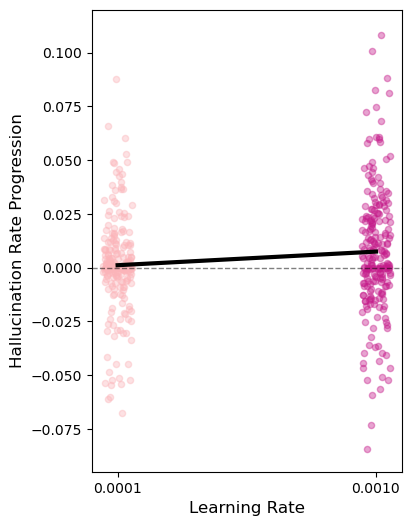

In [19]:
# Plot effects
## Main Effects
### LearnRate
# Extract Data
tmp_et = df_spec_time_long["EffectTime"].values
tmp_lr = df_spec_time_long["LearnRate"].values

regr = linear_model.LinearRegression()
regr.fit(tmp_lr.reshape(-1, 1), tmp_et.reshape(-1, 1)).coef_[0][0]
et_pred = regr.predict(np.array([0.0001, 0.001]).reshape(-1, 1))

# Plot
colors = ["#fbb4b9", "#c51b8a"]
fig_lr, axs = plt.subplots(figsize=(4, 6))
jitter = np.random.uniform(-0.00005, 0.00005, int(len(tmp_et)/2)).reshape(1, -1)
# Reference line
axs.axhline(0, color="k", ls="--", lw=1, alpha=0.5)
for k, lr in enumerate([0.0001, 0.001]):
    tmp_et = df_spec_time_long[df_spec_time_long["LearnRate"] == lr]["EffectTime"].values
    tmp_lr = df_spec_time_long[df_spec_time_long["LearnRate"] == lr]["LearnRate"].values
    axs.scatter(tmp_lr+jitter, tmp_et, alpha=0.4, s=20, color=colors[k])
axs.plot(np.array([0.0001, 0.001]), et_pred, color="black", lw=3)
axs.set_xlim([0.00001, 0.00109])
axs.set_xticks([0.0001, 0.001])
axs.set_ylim([-0.095, 0.12])
axs.set_xlabel("Learning Rate", fontsize=12)
axs.set_ylabel("Hallucination Rate Progression", fontsize=12)
plt.savefig("/".join([spec_halluc_time_dir, "effect_lr.png"]), bbox_inches='tight')

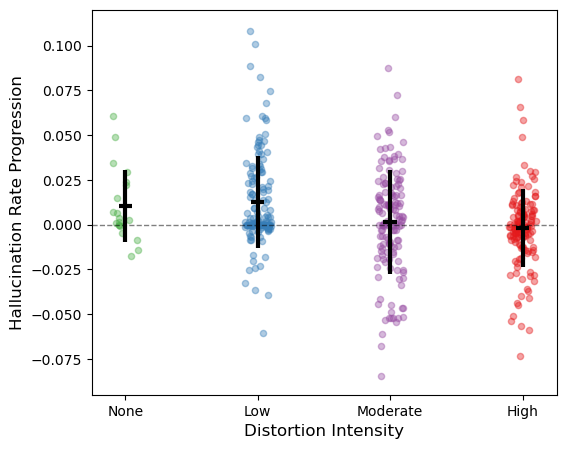

In [20]:
### Intensity
fig_int, axs = plt.subplots(figsize=(6, 5))
colors = ["#4daf4a", "#377eb8", "#984ea3", "#e41a1c"]
# Reference line
axs.axhline(0, color="k", ls="--", lw=1, alpha=0.5)
axs.set_xticks([0, 1, 2, 3])
tmp_et_int = df_spec_time_long[["Intensity", "EffectTime"]]
for i, intense in enumerate(["None", "Low", "Moderate", "High"]):
    # Filter Data
    tmp_data = tmp_et_int[tmp_et_int["Intensity"] == intense]

    # Find mean and standard deviation
    tmp_mean = tmp_data["EffectTime"].values.mean()
    tmp_sd = tmp_data["EffectTime"].values.std()
    axs.errorbar(i, tmp_mean, yerr=tmp_sd, xerr=0.05, linestyle='', elinewidth=3, color="black")
    
    # Add jitter
    jitter = np.random.uniform(-0.1, 0.1, tmp_data.shape[0]).reshape(1, -1)
    
    # Plot
    axs.scatter(jitter+np.ones((1, tmp_data.shape[0]))*i, tmp_data["EffectTime"], alpha=0.4, s=20, color=colors[i])
axs.set_ylim([-0.095, 0.12])
axs.set_xticklabels(["None", "Low", "Moderate", "High"])
axs.set_xlabel("Distortion Intensity", fontsize=12)
axs.set_ylabel("Hallucination Rate Progression", fontsize=12)
plt.savefig("/".join([spec_halluc_time_dir, "effect_int.png"]), bbox_inches='tight')

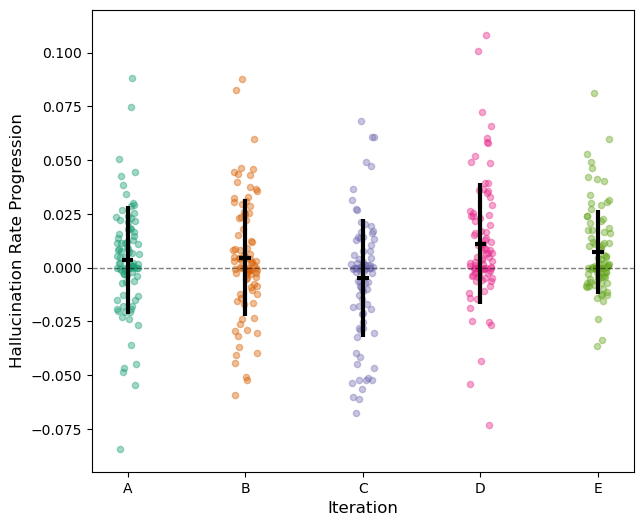

In [21]:
### Iteration
colors = ["#1b9e77", "#d95f02", "#7570b3", "#e7298a", "#66a61e"]
fig_itr, axs = plt.subplots(figsize=(7, 6))
# Reference line
axs.axhline(0, color="k", ls="--", lw=1, alpha=0.5)
axs.set_xticks([0, 1, 2, 3, 4])
tmp_et_int = df_spec_time_long[["Iteration", "EffectTime"]]
for i, intense in enumerate(itrs):
    # Filter Data
    tmp_data = tmp_et_int[tmp_et_int["Iteration"] == intense]

    # Find mean and standard deviation
    tmp_mean = tmp_data["EffectTime"].values.mean()
    tmp_sd = tmp_data["EffectTime"].values.std()
    axs.errorbar(i, tmp_mean, yerr=tmp_sd, xerr=0.05, linestyle='', elinewidth=3, color="black")
    
    # Add jitter
    jitter = np.random.uniform(-0.1, 0.1, tmp_data.shape[0]).reshape(1, -1)
    
    # Plot
    axs.scatter(jitter+np.ones((1, tmp_data.shape[0]))*i, tmp_data["EffectTime"], alpha=0.4, s=20, color=colors[i])
axs.set_ylim([-0.095, 0.12])
axs.set_xticklabels(itrs)
axs.set_xlabel("Iteration", fontsize=12)
axs.set_ylabel("Hallucination Rate Progression", fontsize=12)
plt.savefig("/".join([spec_halluc_time_dir, "effect_itr.png"]), bbox_inches='tight')

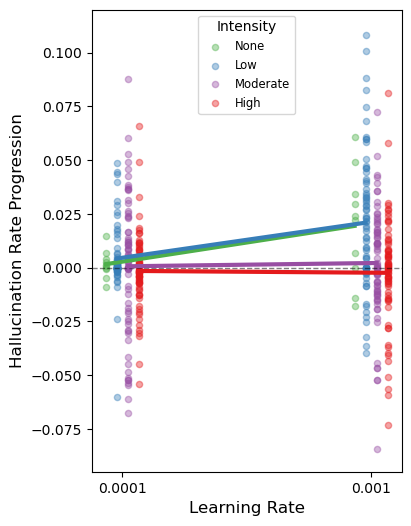

In [22]:
## Interaction
colors = ["#4daf4a", "#377eb8", "#984ea3", "#e41a1c"]
### Learning Rate by Intensity
fig_lrXint, axs = plt.subplots(figsize=(4, 6))
axs.set_xticks([0.0001, 0.001])
tmp_et_lrXint = df_spec_time_long[["LearnRate", "Intensity", "EffectTime"]]
shift = [-0.00006, -0.00002, 0.00002, 0.00006]
for i, intense in enumerate(["None", "Low", "Moderate", "High"]):
    # Filter Data
    tmp_data = tmp_et_lrXint[tmp_et_lrXint["Intensity"] == intense]

    # Fit Regression
    regr = linear_model.LinearRegression()
    regr.fit(tmp_data["LearnRate"].values.reshape(-1, 1), tmp_data["EffectTime"].values.reshape(-1, 1)).coef_[0][0]
    et_pred = regr.predict(np.array([0.0001, 0.001]).reshape(-1, 1))
    
    # Add jitter
    #jitter = np.random.uniform(-0.00005, 0.00005, tmp_data.shape[0]).reshape(1, -1)
    
    # Plot
    axs.errorbar([shift[i]+0.0001, shift[i]+0.001], et_pred, xerr=None, lw=3, color=colors[i])
    axs.scatter(shift[i]+tmp_data["LearnRate"].values, tmp_data["EffectTime"].values, alpha=0.4 , s=20, color=colors[i])
axs.set_ylim([-0.095, 0.12])
axs.set_xticklabels([0.0001, 0.001])
axs.set_xlabel("Learning Rate", fontsize=12)
axs.set_ylabel("Hallucination Rate Progression", fontsize=12)
axs.legend(["None", "Low", "Moderate", "High"], title="Intensity", fontsize='small', fancybox=True, loc="upper center")
axs.axhline(0, color="k", ls="--", lw=1, alpha=0.5)
plt.savefig("/".join([spec_halluc_time_dir, "effect_lrXint.png"]), bbox_inches='tight')

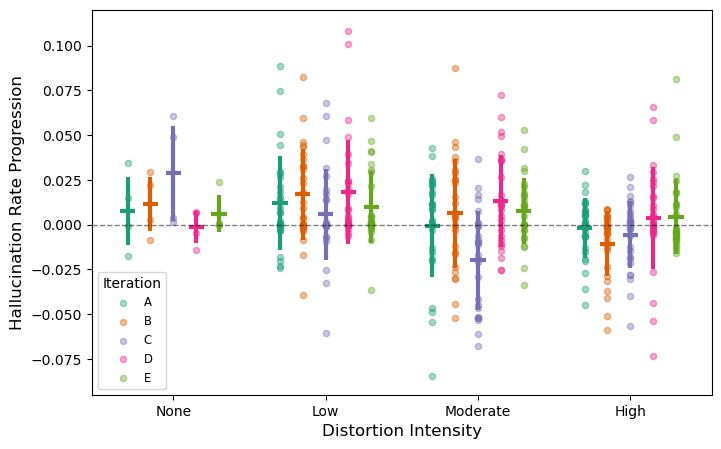

In [23]:
### Intensity
fig_intXitr, axs = plt.subplots(figsize=(8, 5))
# Reference line
colors = ["#1b9e77", "#d95f02", "#7570b3", "#e7298a", "#66a61e"]
axs.set_xticks([0, 1, 2, 3])
shift = [-0.3, -0.15, 0.0, 0.15, 0.3]
tmp_et_int = df_spec_time_long[["Intensity", "Iteration", "EffectTime"]]
for i, intense in enumerate(["None", "Low", "Moderate", "High"]):
    for j, itr in enumerate(itrs):
        # Filter Data
        tmp_data = tmp_et_int[(tmp_et_int["Intensity"] == intense) & (tmp_et_int["Iteration"] == itr)]
    
        # Find mean and standard deviation
        tmp_mean = tmp_data["EffectTime"].values.mean()
        tmp_sd = tmp_data["EffectTime"].values.std()
        axs.errorbar(shift[j]+i, tmp_mean, yerr=tmp_sd, xerr=0.05, linestyle='', elinewidth=3, color=colors[j])
        
        # Add jitter
        jitter = np.random.uniform(-0.1, 0.1, tmp_data.shape[0]).reshape(1, -1)
        
        # Plot
        axs.scatter(shift[j]+np.ones((1, tmp_data.shape[0]))*i, tmp_data["EffectTime"], alpha=0.4, s=20, color=colors[j])
axs.set_ylim([-0.095, 0.12])
axs.set_xticklabels(["None", "Low", "Moderate", "High"])
axs.set_xlabel("Distortion Intensity", fontsize=12)
axs.set_ylabel("Hallucination Rate Progression", fontsize=12)
axs.legend(itrs, title="Iteration", fontsize='small', fancybox=True, loc="lower left")
axs.axhline(0, color="k", ls="--", lw=1, alpha=0.5)
plt.savefig("/".join([spec_halluc_time_dir, "effect_intXitr.png"]), bbox_inches='tight')

In [24]:
# CONFIDENCE ANALYSIS
conf_dir = "/".join([result_dir, "conf"])
if not os.path.isdir(conf_dir):
    os.makedirs(conf_dir)

In [25]:
# Instantiate loop variables
dict_conf = {"Model": [], "Intensity": [], "TimePoint": [], "A": [], "B": [], "C": [], "D": [], "E": []}

# Gather hallucination rates
for mdl_lst in store_dist: # Distortion types
    for j, dist in enumerate(mdl_lst):
        for lr in lrs: # Learning rate types
            for expect in expects: # Expectation type
                # Full model name
                mdl = "_".join([expect, dist, lr])
    
                # Model time points
                models = ["_".join([mdl, str(i)]) for i in mod]
    
                for model in models: # Go through time points
                    # Store model
                    dict_conf["Model"].append(mdl)
                    dict_conf["TimePoint"].append(int(model.split("_")[-1]))
                    if "CL00050" in mdl_lst[0]:
                        dict_conf["Intensity"].append("None")
                    elif j == 0:
                        dict_conf["Intensity"].append("Low")
                    elif j == 1:
                        dict_conf["Intensity"].append("Moderate")
                    elif j == 2:
                        dict_conf["Intensity"].append("High")
                    for itr in itrs: # Different iterations
                        # Test type
                        test_type = mdl2dist(model)
                        
                        # Set data directory
                        data_dir = "/".join([proj_dir, "images", itr, model])

                        # Calculate hallucination rate
                        conf_dist = calc_conf_dist(model, test_type, data_dir, 6)

                        # Store hallucionation rate
                        dict_conf[itr].append(conf_dist)

In [26]:
# Create dataframe from dictionary
df_conf = pd.DataFrame(dict_conf)

# Generate additional columns
tmp_models = df_conf["Model"].values
df_conf["Expectation"] = [bool(int(i.split("_")[0][1])) for i in tmp_models]
df_conf["Distortion"] = [i.split("_")[1][0:2] for i in tmp_models]
df_conf["Value"] = [round(int(i.split("_")[1][2:])*0.001, 2) for i in tmp_models]
df_conf["LearnRate"] = [0.0001 if i.split("_")[2] == '00' else 0.001 for i in tmp_models]

# Reorder
df_conf = df_conf[["Model", "Expectation", "Distortion", "Value", "Intensity", "LearnRate", "TimePoint", "A", "B", "C", "D", "E"]]

# Save to CSV
df_conf.to_csv("/".join([conf_dir, "conf.csv"]), index=False)

In [27]:
fig_conf, axs = plt.subplots(8, 12, figsize=(180, 80))
#plt.legend(itrs+["Polynomial", "Average"], bbox_to_anchor=(1.05, 1.0), loc="upper left")
for i, mdl_lst in enumerate(store_dist): # Distortion types
    j = 0
    if "CL00050" in mdl_lst[0]:
        mdl_lst = mdl_lst*len(store_dist[1])
    for dist in mdl_lst:
        for lr in lrs: # Learning rate types
            for expect in expects: # Expectation type
                # Full model name
                mdl = "_".join([expect, dist, lr])
                
                # Extract data
                df_tmp = df_conf[df_spec_halluc["Model"]==mdl]
                
                # Create arrays
                #if len(tmp)
                itr_conf = df_tmp[itrs].values
                itr_time = repmat(df_tmp["TimePoint"].values, len(itrs), 1)
                
                # Calculate average trace
                avg_conf = np.nanmean(itr_conf, 1)
                sd_conf = np.nanstd(itr_conf, 1)
                
                # Fit polynomial
                #z = np.polyfit(np.array([0, 1, 2, 3, 4]), avg_halluc_rate, 4)
                #p = np.poly1d(z)
                #hr_pred = p(np.linspace(0, 4, num=100))
                
                # Plot results
                for k, itr in enumerate(itrs):
                    axs[i, j].scatter(itr_time[k], itr_conf[:, k], alpha=0.4, linewidth=4)
                #axs[i, j].plot(np.linspace(0, 4, num=100), hr_pred, linewidth=4, color="grey")
                axs[i, j].errorbar(itr_time[0], avg_conf, yerr=sd_conf, linewidth=4, color="black")
                axs[i, j].set_xticks([i for i in range(count)])
                axs[i, j].set_title(mdl, fontsize=30)
                axs[i, j].set_ylim([0.75, 1.01])
                if i == 7:
                    axs[i, j].set_xticklabels(mod)
                    axs[i, j].set_xlabel("Time", fontsize=25)
                else:
                    axs[i, j].set_xticklabels([])
                if j == 0:
                    axs[i, j].set_ylabel("Confidence Distanct", fontsize=25)
                else:
                    axs[i, j].set_yticklabels([])

                # Update index
                j += 1
# Save figure
plt.savefig("/".join([conf_dir, "conf_all.png"]), bbox_inches='tight')

/tmp/ipykernel_1193524/4111027543.py:22: RuntimeWarning: Mean of empty slice
  avg_conf = np.nanmean(itr_conf, 1)
/home/wcp27/.conda/envs/generative/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/tmp/ipykernel_1193524/4111027543.py:22: RuntimeWarning: Mean of empty slice
  avg_conf = np.nanmean(itr_conf, 1)
/home/wcp27/.conda/envs/generative/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/tmp/ipykernel_1193524/4111027543.py:22: RuntimeWarning: Mean of empty slice
  avg_conf = np.nanmean(itr_conf, 1)
/home/wcp27/.conda/envs/generative/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/tmp/ipykernel_1193524/41110275

In [28]:
# CONFIDENCE TIME ANALYSIS
conf_time_dir = "/".join([result_dir, "conf_time"])
if not os.path.isdir(conf_time_dir):
    os.makedirs(conf_time_dir)

In [29]:
# Extract unique models
df_conf_time = df_conf.iloc[0:df_conf.shape[0]:5,:].drop("TimePoint", axis=1).reset_index(drop=True)

for i, mdl in enumerate(df_conf_time["Model"].values):
    # Extract model data
    df_tmp = df_conf[df_conf["Model"] == mdl]

    for itr in itrs:
        # Extract iteration data
        itr_conf = df_tmp[itr].values
        itr_time = df_tmp["TimePoint"].values

        # Fit linear model
        bool_nan = np.isnan(itr_conf)
        if sum(bool_nan) < 2:
            itr_conf = itr_conf[np.invert(bool_nan)]
            itr_time = itr_time[np.invert(bool_nan)]
            tmp_lm = linear_model.LinearRegression().fit(itr_time.reshape(-1, 1), itr_conf.reshape(-1, 1)).coef_[0][0]
        else:
            tmp_lm = np.nan

        # Save effect of time
        df_conf_time.at[i, itr] = tmp_lm

In [30]:
# Generate additional columns
df_conf_time["Mean"] = np.nanmean(df_conf_time[itrs].values, 1)
df_conf_time["SD"] = np.nanstd(df_conf_time[itrs].values, 1)

# Save to CSV
df_conf_time.to_csv("/".join([conf_time_dir, "conf_time.csv"]), index=False)

/tmp/ipykernel_1193524/1625066939.py:2: RuntimeWarning: Mean of empty slice
  df_conf_time["Mean"] = np.nanmean(df_conf_time[itrs].values, 1)
/home/wcp27/.conda/envs/generative/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


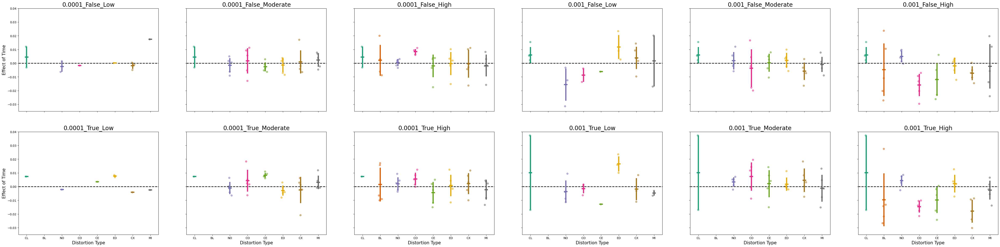

In [31]:
j=0
jitter = np.random.uniform(-0.1, 0.1, 5).reshape(1, -1)
fig_conf_time, axs = plt.subplots(2, 6, figsize=(60, 14))

for i, expect in enumerate([False, True]):
    j = 0
    for lr in [0.0001, 0.001]:
        for intense in intensities:
            # Filter data frame
            df_tmp = df_conf_time[(df_conf_time["Expectation"] == expect) & (df_conf_time["LearnRate"] == lr)]
            df_tmp = df_tmp[(df_tmp["Intensity"] == intense) | (df_tmp["Intensity"] == "None")]

            # Plot values
            axs[i, j].axhline(0, color="k", ls="--", lw=2)
            for k, dist in enumerate(type_dist):
                # Extract points
                tmp_point = df_tmp[df_tmp["Distortion"] == dist][itrs].values
                axs[i, j].scatter(np.ones((1,5))*k+jitter, tmp_point, alpha=0.5)
                
                # Extract Mean and SD
                tmp_mean = df_tmp[df_tmp["Distortion"] == dist]["Mean"].values
                tmp_sd = df_tmp[df_tmp["Distortion"] == dist]["SD"].values
                axs[i, j].errorbar(k, tmp_mean, yerr=tmp_sd, xerr=0.1, linestyle='', elinewidth=4)
            
            # Formatting
            axs[i, j].set_xticks([i for i in range(len(type_dist))])
            axs[i, j].set_title("_".join([str(lr), str(expect), intense]), fontsize=20)
            axs[i, j].set_ylim([-0.035, 0.04])
            if i == 1:
                axs[i, j].set_xticklabels(type_dist)
                axs[i, j].set_xlabel("Distortion Type", fontsize=15)
            else:
                axs[i, j].set_xticklabels([])
            if j == 0:
                axs[i, j].set_ylabel("Effect of Time", fontsize=15)
            else:
                axs[i, j].set_yticklabels([])
                    
            j += 1
plt.savefig("/".join([conf_time_dir, "conf_time_all.png"]), bbox_inches='tight')

In [32]:
# Transform data to long format
df_conf_time_long = df_conf_time[["Model", "Expectation", "Distortion", "Intensity", "LearnRate","A", "B", "C", "D", "E"]].melt(
    id_vars=["Model", "Expectation", "Distortion", "Intensity", "LearnRate"], var_name="Iteration", value_name="EffectTime")

# Create a level variable
level = []
for dist in df_conf_time_long["Distortion"].values:
    if dist == "CL":
        level.append("None")
    elif dist == "BL" or dist == "NO":
        level.append("Peripheral")
    else:
        level.append("PrimaryCtx")
df_conf_time_long["Level"] = level

# Reorder
df_conf_time_long = df_conf_time_long[["Model", "Expectation", "Distortion", "Level", "Intensity", "LearnRate", "Iteration", "EffectTime"]]

# Save to CSV
df_conf_time_long.to_csv("/".join([conf_time_dir, "conf_time_long.csv"]), index=False)

In [33]:
# Statistical Testing
df_conf_time_long = df_conf_time_long.dropna().reset_index(drop=True)
lm_conf = ols(formula="EffectTime ~ C(Expectation) + LearnRate + C(Intensity) + C(Distortion) + C(Level) + C(Iteration) + LearnRate*C(Intensity)", 
         data=df_conf_time_long).fit()
#print(lm_conf.summary())
table_conf = sm.stats.anova_lm(lm_conf, typ=2)
print(table_conf)

                          sum_sq     df         F    PR(>F)
C(Expectation)          0.000092    1.0  0.946236  0.331476
C(Intensity)            0.001534    3.0  5.266683  0.001493
C(Distortion)           0.000675    7.0  0.992868  0.436475
C(Level)                0.000002    2.0  0.012000  0.988072
C(Iteration)            0.001457    4.0  3.752295  0.005391
LearnRate               0.000858    1.0  8.837200  0.003195
LearnRate:C(Intensity)  0.000966    3.0  3.317296  0.020306
Residual                0.028637  295.0       NaN       NaN


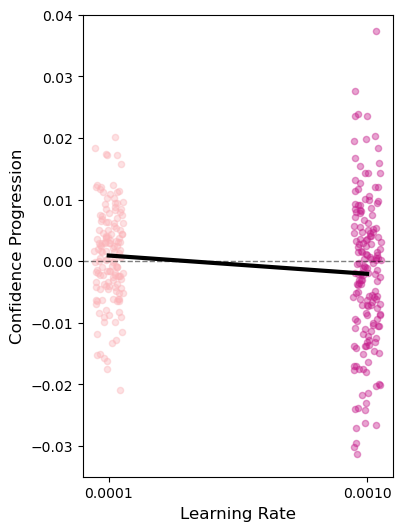

In [34]:
# Plot effects
## Main Effects
### LearnRate
# Extract Data
tmp_et = df_conf_time_long["EffectTime"].values
tmp_lr = df_conf_time_long["LearnRate"].values

regr = linear_model.LinearRegression()
regr.fit(tmp_lr.reshape(-1, 1), tmp_et.reshape(-1, 1)).coef_[0][0]
et_pred = regr.predict(np.array([0.0001, 0.001]).reshape(-1, 1))

# Plot
colors = ["#fbb4b9", "#c51b8a"]
fig_lr, axs = plt.subplots(figsize=(4, 6))
# Reference line
axs.axhline(0, color="k", ls="--", lw=1, alpha=0.5)
for k, lr in enumerate([0.0001, 0.001]):
    tmp_et = df_conf_time_long[df_conf_time_long["LearnRate"] == lr]["EffectTime"].values
    tmp_lr = df_conf_time_long[df_conf_time_long["LearnRate"] == lr]["LearnRate"].values
    jitter = np.random.uniform(-0.00005, 0.00005, len(tmp_et)).reshape(1, -1)
    axs.scatter(tmp_lr+jitter, tmp_et, alpha=0.4, s=20, color=colors[k])
axs.plot(np.array([0.0001, 0.001]), et_pred, color="black", lw=3)
axs.set_xlim([0.00001, 0.00109])
axs.set_xticks([0.0001, 0.001])
axs.set_ylim([-0.035, 0.04])
axs.set_xlabel("Learning Rate", fontsize=12)
axs.set_ylabel("Confidence Progression", fontsize=12)
plt.savefig("/".join([conf_time_dir, "effect_lr.png"]), bbox_inches='tight')

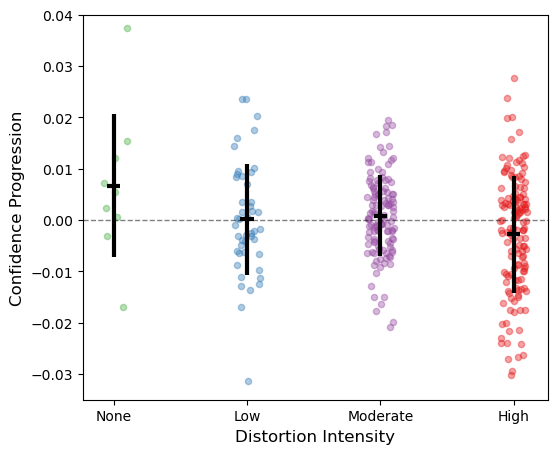

In [35]:
### Intensity
fig_int, axs = plt.subplots(figsize=(6, 5))
# Reference line
colors = ["#4daf4a", "#377eb8", "#984ea3", "#e41a1c"]
axs.axhline(0, color="k", ls="--", lw=1, alpha=0.5)
axs.set_xticks([0, 1, 2, 3])
tmp_et_int = df_conf_time_long[["Intensity", "EffectTime"]]
for i, intense in enumerate(["None", "Low", "Moderate", "High"]):
    # Filter Data
    tmp_data = tmp_et_int[tmp_et_int["Intensity"] == intense]

    # Find mean and standard deviation
    tmp_mean = tmp_data["EffectTime"].values.mean()
    tmp_sd = tmp_data["EffectTime"].values.std()
    axs.errorbar(i, tmp_mean, yerr=tmp_sd, xerr=0.05, linestyle='', elinewidth=3, color="black")
    
    # Add jitter
    jitter = np.random.uniform(-0.1, 0.1, tmp_data.shape[0]).reshape(1, -1)
    
    # Plot
    axs.scatter(jitter+np.ones((1, tmp_data.shape[0]))*i, tmp_data["EffectTime"], alpha=0.4, s=20, color=colors[i])
axs.set_ylim([-0.035, 0.04])
axs.set_xticklabels(["None", "Low", "Moderate", "High"])
axs.set_xlabel("Distortion Intensity", fontsize=12)
axs.set_ylabel("Confidence Progression", fontsize=12)
plt.savefig("/".join([conf_time_dir, "effect_int.png"]), bbox_inches='tight')

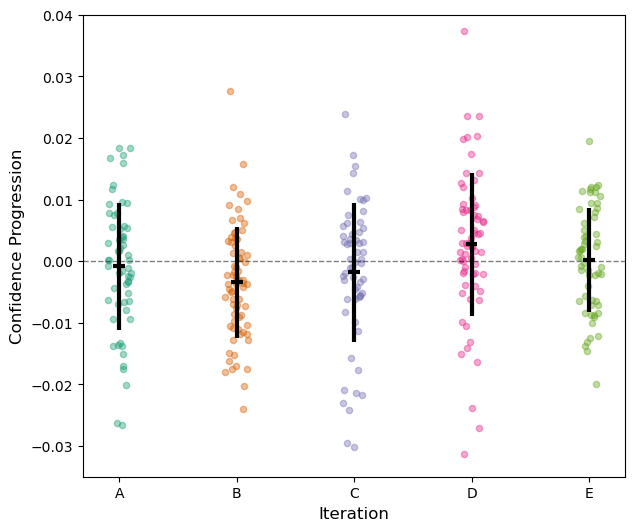

In [36]:
### Iteration
fig_itr, axs = plt.subplots(figsize=(7, 6))
# Reference line
colors = ["#1b9e77", "#d95f02", "#7570b3", "#e7298a", "#66a61e"]
axs.axhline(0, color="k", ls="--", lw=1, alpha=0.5)
axs.set_xticks([0, 1, 2, 3, 4])
tmp_et_int = df_conf_time_long[["Iteration", "EffectTime"]]
for i, intense in enumerate(itrs):
    # Filter Data
    tmp_data = tmp_et_int[tmp_et_int["Iteration"] == intense]

    # Find mean and standard deviation
    tmp_mean = tmp_data["EffectTime"].values.mean()
    tmp_sd = tmp_data["EffectTime"].values.std()
    axs.errorbar(i, tmp_mean, yerr=tmp_sd, xerr=0.05, linestyle='', elinewidth=3, color="black")
    
    # Add jitter
    jitter = np.random.uniform(-0.1, 0.1, tmp_data.shape[0]).reshape(1, -1)
    
    # Plot
    axs.scatter(jitter+np.ones((1, tmp_data.shape[0]))*i, tmp_data["EffectTime"], alpha=0.4, s=20, color=colors[i])
axs.set_ylim([-0.035, 0.04])
axs.set_xticklabels(itrs)
axs.set_xlabel("Iteration", fontsize=12)
axs.set_ylabel("Confidence Progression", fontsize=12)
plt.savefig("/".join([conf_time_dir, "effect_itr.png"]), bbox_inches='tight')

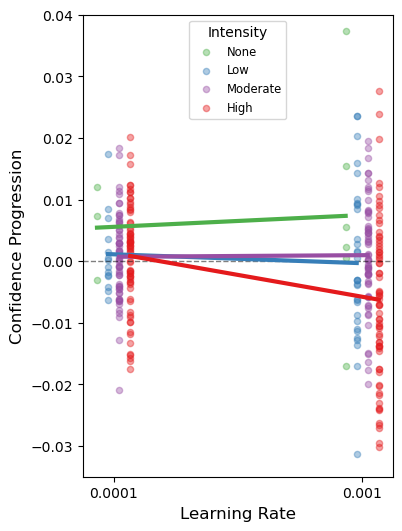

In [37]:
## Interaction
### Learning Rate by Intensity
colors = ["#4daf4a", "#377eb8", "#984ea3", "#e41a1c"]
fig_lrXint, axs = plt.subplots(figsize=(4, 6))
axs.set_xticks([0.0001, 0.001])
tmp_et_lrXint = df_conf_time_long[["LearnRate", "Intensity", "EffectTime"]]
shift = [-0.00006, -0.00002, 0.00002, 0.00006]
for i, intense in enumerate(["None", "Low", "Moderate", "High"]):
    # Filter Data
    tmp_data = tmp_et_lrXint[tmp_et_lrXint["Intensity"] == intense]

    # Fit Regression
    regr = linear_model.LinearRegression()
    regr.fit(tmp_data["LearnRate"].values.reshape(-1, 1), tmp_data["EffectTime"].values.reshape(-1, 1)).coef_[0][0]
    et_pred = regr.predict(np.array([0.0001, 0.001]).reshape(-1, 1))
    
    # Add jitter
    #jitter = np.random.uniform(-0.00005, 0.00005, tmp_data.shape[0]).reshape(1, -1)
    
    # Plot
    axs.errorbar([shift[i]+0.0001, shift[i]+0.001], et_pred, xerr=None, lw=3, color=colors[i])
    axs.scatter(shift[i]+tmp_data["LearnRate"].values, tmp_data["EffectTime"].values, alpha=0.4 , s=20, color=colors[i])
axs.set_ylim([-0.035, 0.04])
axs.set_xticklabels([0.0001, 0.001])
axs.set_xlabel("Learning Rate", fontsize=12)
axs.set_ylabel("Confidence Progression", fontsize=12)
axs.legend(["None", "Low", "Moderate", "High"], title="Intensity", fontsize='small', fancybox=True, loc="upper center")
axs.axhline(0, color="k", ls="--", lw=1, alpha=0.5)
plt.savefig("/".join([conf_time_dir, "effect_lrXint.png"]), bbox_inches='tight')

In [38]:
# PRIOR CORRELATION ANALYSIS
prior_corr_dir = "/".join([result_dir, "prior_corr"])
if not os.path.isdir(prior_corr_dir):
    os.makedirs(prior_corr_dir)

In [39]:
# Instantiate loop variables
dict_prior_corr = {"Model": [], "Intensity": [], "TimePoint": [], "A": [], "B": [], "C": [], "D": [], "E": []}

# Gather hallucination rates
for mdl_lst in store_dist: # Distortion types
    for j, dist in enumerate(mdl_lst):
        for lr in lrs: # Learning rate types
            for expect in expects: # Expectation type
                # Full model name
                mdl = "_".join([expect, dist, lr])
    
                # Model time points
                models = ["_".join([mdl, str(i)]) for i in mod]
    
                for model in models: # Go through time points
                    if (expect == "A1") and (not model.endswith("0")):
                        # Store model
                        dict_prior_corr["Model"].append(mdl)
                        dict_prior_corr["TimePoint"].append(int(model.split("_")[-1]))
                        if "CL00050" in mdl_lst[0]:
                            dict_prior_corr["Intensity"].append("None")
                        elif j == 0:
                            dict_prior_corr["Intensity"].append("Low")
                        elif j == 1:
                            dict_prior_corr["Intensity"].append("Moderate")
                        elif j == 2:
                            dict_prior_corr["Intensity"].append("High")
                        for itr in itrs: # Different iterations
                            # Test type
                            test_type = mdl2dist(model)
                            
                            # Set data directory
                            data_dir = "/".join([proj_dir, "images", itr, model])
    
                            # Calculate hallucination rate
                            prior_corr = calc_prior_corr(model, test_type, data_dir, 6)
    
                            # Store hallucionation rate
                            dict_prior_corr[itr].append(prior_corr)

In [40]:
# Create dataframe from dictionary
df_prior_corr = pd.DataFrame(dict_prior_corr)

# Generate additional columns
tmp_models = df_prior_corr["Model"].values
df_prior_corr["Expectation"] = [bool(int(i.split("_")[0][1])) for i in tmp_models]
df_prior_corr["Distortion"] = [i.split("_")[1][0:2] for i in tmp_models]
df_prior_corr["Value"] = [round(int(i.split("_")[1][2:])*0.001, 2) for i in tmp_models]
df_prior_corr["LearnRate"] = [0.0001 if i.split("_")[2] == '00' else 0.001 for i in tmp_models]

# Reorder
df_prior_corr = df_prior_corr[["Model", "Expectation", "Distortion", "Value", "Intensity", "LearnRate", "TimePoint", "A", "B", "C", "D", "E"]]

# Save to CSV
df_prior_corr.to_csv("/".join([prior_corr_dir, "prior_corr.csv"]), index=False)

/tmp/ipykernel_1193524/112524801.py:22: RuntimeWarning: Mean of empty slice
  avg_prior_corr = np.nanmean(itr_prior_corr, 1)
/home/wcp27/.conda/envs/generative/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/tmp/ipykernel_1193524/112524801.py:22: RuntimeWarning: Mean of empty slice
  avg_prior_corr = np.nanmean(itr_prior_corr, 1)
/home/wcp27/.conda/envs/generative/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/tmp/ipykernel_1193524/112524801.py:22: RuntimeWarning: Mean of empty slice
  avg_prior_corr = np.nanmean(itr_prior_corr, 1)
/home/wcp27/.conda/envs/generative/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof

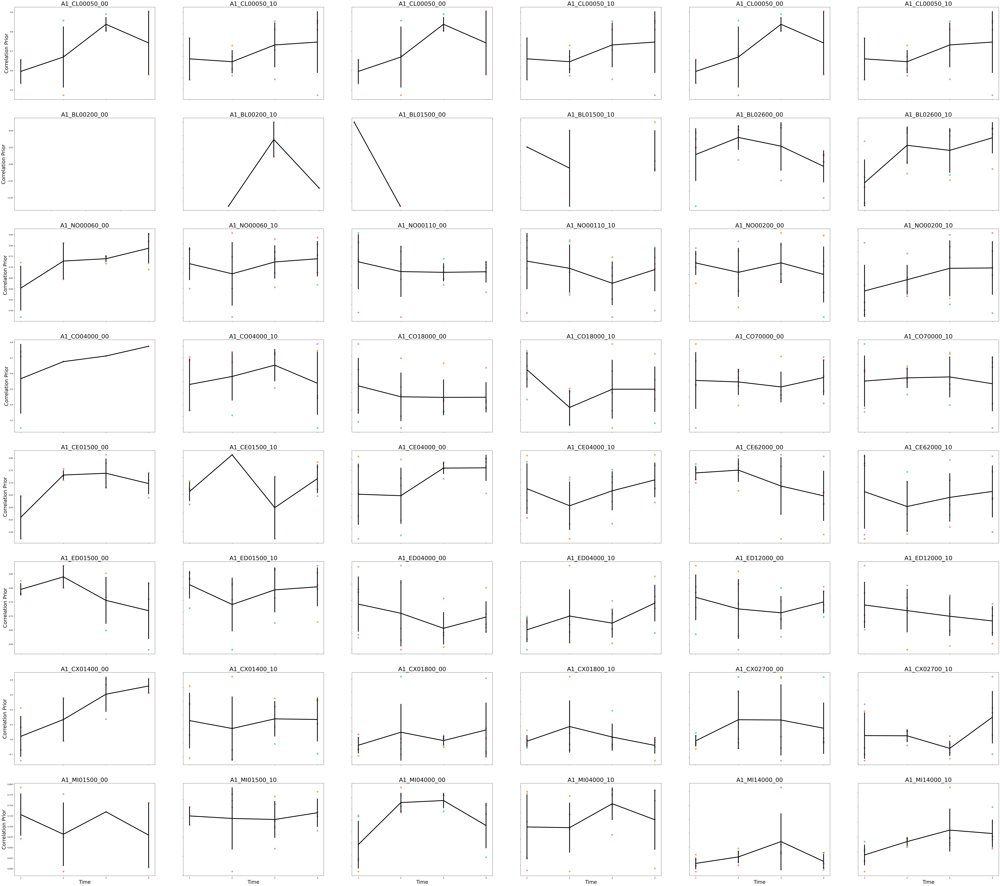

In [41]:
fig_conf, axs = plt.subplots(8, 6, figsize=(90, 80))
#plt.legend(itrs+["Polynomial", "Average"], bbox_to_anchor=(1.05, 1.0), loc="upper left")
for i, mdl_lst in enumerate(store_dist): # Distortion types
    j = 0
    if "CL00050" in mdl_lst[0]:
        mdl_lst = mdl_lst*len(store_dist[1])
    for dist in mdl_lst:
        for lr in lrs: # Learning rate types
            for expect in expects: # Expectation type
                if expect == "A1":
                    # Full model name
                    mdl = "_".join([expect, dist, lr])
    
                    # Extract data
                    df_tmp = df_prior_corr[df_prior_corr["Model"]==mdl]
                    
                    # Create arrays
                    itr_prior_corr = df_tmp[itrs].values
                    itr_time = repmat(df_tmp["TimePoint"].values, len(itrs), 1)
    
                    # Calculate average trace
                    avg_prior_corr = np.nanmean(itr_prior_corr, 1)
                    sd_prior_corr = np.nanstd(itr_prior_corr, 1)
                    
                    # Fit polynomial
                    #z = np.polyfit(np.array([0, 1, 2, 3, 4]), avg_prior_corr, 4)
                    #p = np.poly1d(z)
                    #hr_pred = p(np.linspace(0, 4, num=100))
                    
                    # Plot results
                    # Plot results
                    for k, itr in enumerate(itrs):
                        axs[i, j].scatter(itr_time[k], itr_prior_corr[:, k], alpha=0.4, linewidth=4)
                    #axs[i, j].plot(np.linspace(0, 4, num=100), hr_pred, linewidth=4, color="grey")
                    axs[i, j].errorbar(itr_time[0], avg_prior_corr, yerr=sd_prior_corr, linewidth=4, color="black")
                    axs[i, j].set_xticks(itr_time[0])
                    axs[i, j].set_title(mdl, fontsize=30)
                    #axs[i, j].set_ylim([-0.01, 0.65])
                    if i == 7:
                        axs[i, j].set_xticklabels(itr_time[0])
                        axs[i, j].set_xlabel("Time", fontsize=25)
                    else:
                        axs[i, j].set_xticklabels([])
                    if j == 0:
                        axs[i, j].set_ylabel("Correlation Prior", fontsize=25)
                    else:
                        axs[i, j].set_yticklabels([])
    
                    # Update index
                    j += 1
# Save figure
plt.savefig("/".join([prior_corr_dir, "prior_corr_all.png"]), bbox_inches='tight')

In [42]:
# PRIOR CORRELATION TIME ANALYSIS
prior_corr_time_dir = "/".join([result_dir, "prior_corr_time"])
if not os.path.isdir(prior_corr_time_dir):
    os.makedirs(prior_corr_time_dir)

In [43]:
# Extract unique models
df_prior_corr_time = df_prior_corr.iloc[0:df_prior_corr.shape[0]:4,:].drop("TimePoint", axis=1).reset_index(drop=True)

for i, mdl in enumerate(df_prior_corr_time["Model"].values):
    # Extract model data
    df_tmp = df_prior_corr[df_prior_corr["Model"] == mdl]

    for itr in itrs:
        # Extract iteration data
        itr_prior_corr = df_tmp[itr].values
        itr_time = df_tmp["TimePoint"].values

        # Fit linear model
        bool_nan = np.isnan(itr_prior_corr)
        if sum(bool_nan) < 2:
            itr_prior_corr = itr_prior_corr[np.invert(bool_nan)]
            itr_time = itr_time[np.invert(bool_nan)]
            tmp_lm = linear_model.LinearRegression().fit(itr_time.reshape(-1, 1), itr_prior_corr.reshape(-1, 1)).coef_[0][0]
        else:
            tmp_lm = np.nan

        # Save effect of time
        df_prior_corr_time.at[i, itr] = tmp_lm

In [44]:
# Generate additional columns
df_prior_corr_time["Mean"] = np.nanmean(df_prior_corr_time[itrs].values, 1)
df_prior_corr_time["SD"] = np.nanstd(df_prior_corr_time[itrs].values, 1)

# Save to CSV
df_prior_corr_time.to_csv("/".join([prior_corr_time_dir, "prior_corr_time.csv"]), index=False)

/tmp/ipykernel_1193524/937049680.py:2: RuntimeWarning: Mean of empty slice
  df_prior_corr_time["Mean"] = np.nanmean(df_prior_corr_time[itrs].values, 1)
/home/wcp27/.conda/envs/generative/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


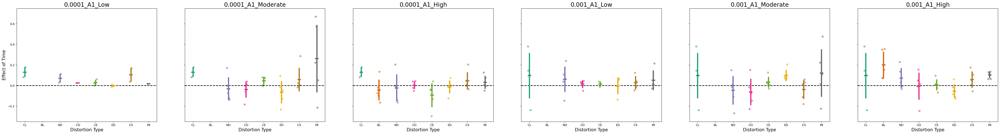

In [45]:
j=0
jitter = np.random.uniform(-0.1, 0.1, 5).reshape(1, -1)
fig_prior_time, axs = plt.subplots(1, 6, figsize=(60, 7))

j = 0
for lr in [0.0001, 0.001]:
    for intense in intensities:
        # Filter data frame
        df_tmp = df_prior_corr_time[(df_prior_corr_time["LearnRate"] == lr)]
        df_tmp = df_tmp[(df_tmp["Intensity"] == intense) | (df_tmp["Intensity"] == "None")]

        # Plot values
        axs[j].axhline(0, color="k", ls="--", lw=2)
        for k, dist in enumerate(type_dist):
            # Extract points
            tmp_point = df_tmp[df_tmp["Distortion"] == dist][itrs].values
            axs[j].scatter(np.ones((1,5))*k+jitter, tmp_point, alpha=0.5)
                
            # Extract Mean and SD
            tmp_mean = df_tmp[df_tmp["Distortion"] == dist]["Mean"].values
            tmp_sd = df_tmp[df_tmp["Distortion"] == dist]["SD"].values
            axs[j].errorbar(k, tmp_mean, yerr=tmp_sd, xerr=0.1, linestyle='', elinewidth=4)
            
        # Formatting
        axs[j].set_xticks([i for i in range(len(type_dist))])
        axs[j].set_title("_".join([str(lr), str(expect), intense]), fontsize=20)
        axs[j].set_ylim([-0.35, 0.75])
        axs[j].set_xticklabels(type_dist)
        axs[j].set_xlabel("Distortion Type", fontsize=15)
        if j == 0:
            axs[j].set_ylabel("Effect of Time", fontsize=15)
        else:
            axs[j].set_yticklabels([])
                    
        j += 1
plt.savefig("/".join([prior_corr_time_dir, "prior_corr_time_all.png"]), bbox_inches='tight')

In [46]:
# Transform data to long format
df_prior_corr_time_long = df_prior_corr_time[["Model", "Expectation", "Distortion", "Intensity", "LearnRate","A", "B", "C", "D", "E"]].melt(
    id_vars=["Model", "Expectation", "Distortion", "Intensity", "LearnRate"], var_name="Iteration", value_name="EffectTime")

# Create a level variable
level = []
for dist in df_prior_corr_time_long["Distortion"].values:
    if dist == "CL":
        level.append("None")
    elif dist == "BL" or dist == "NO":
        level.append("Peripheral")
    else:
        level.append("PrimaryCtx")
df_prior_corr_time_long["Level"] = level

# Reorder
df_prior_corr_time_long = df_prior_corr_time_long[["Model", "Expectation", "Distortion", "Level", "Intensity", "LearnRate", "Iteration", "EffectTime"]]

# Save to CSV
df_prior_corr_time_long.to_csv("/".join([prior_corr_time_dir, "prior_corr_time_long.csv"]), index=False)

In [47]:
# Statistical Testing
df_prior_corr_time_long = df_prior_corr_time_long.dropna().reset_index(drop=True)
lm_prior_corr = ols(formula="EffectTime ~  LearnRate + C(Intensity) + C(Distortion) + C(Level) + C(Iteration) + LearnRate*C(Distortion)",
         data=df_prior_corr_time_long).fit()
#print(lm_prior_corr.summary())
table_prior_corr = sm.stats.anova_lm(lm_prior_corr, typ=2)
print(table_prior_corr)

                           sum_sq     df         F    PR(>F)
C(Intensity)             0.043302    3.0  0.849108  0.469151
C(Distortion)            0.367324    7.0  3.086910  0.004577
C(Level)                 0.049041    2.0  1.442455  0.239650
C(Iteration)             0.089758    4.0  1.320035  0.265175
LearnRate                0.014759    1.0  0.868245  0.352959
LearnRate:C(Distortion)  0.194874    7.0  1.637680  0.129066
Residual                 2.515876  148.0       NaN       NaN


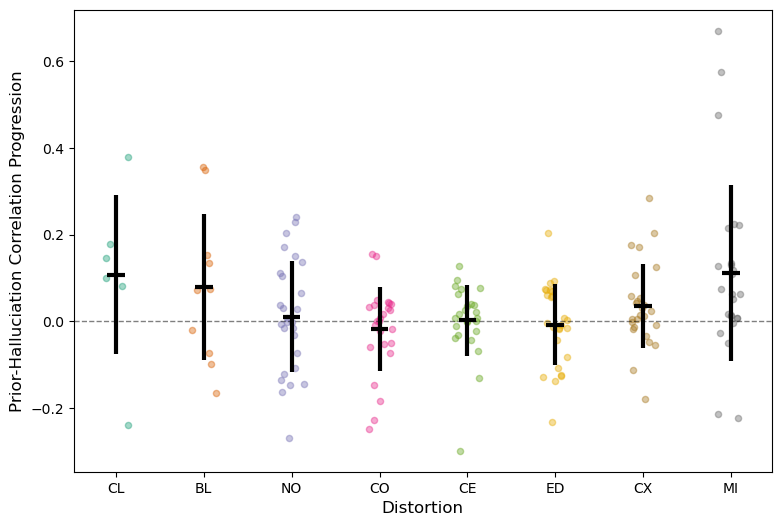

In [48]:
### Iteration
fig_dist, axs = plt.subplots(figsize=(9, 6))
# Reference line
axs.axhline(0, color="k", ls="--", lw=1, alpha=0.5)
axs.set_xticks([0, 1, 2, 3, 4, 5, 6, 7])
tmp_et_int = df_prior_corr_time_long[["Distortion", "EffectTime"]]
for i, distort in enumerate(type_dist):
    # Filter Data
    tmp_data = tmp_et_int[tmp_et_int["Distortion"] == distort]

    # Find mean and standard deviation
    tmp_mean = tmp_data["EffectTime"].values.mean()
    tmp_sd = tmp_data["EffectTime"].values.std()
    axs.errorbar(i, tmp_mean, yerr=tmp_sd, xerr=0.1, linestyle='', elinewidth=3, color="black")
    
    # Add jitter
    jitter = np.random.uniform(-0.15, 0.15, tmp_data.shape[0]).reshape(1, -1)
    
    # Plot
    axs.scatter(jitter+np.ones((1, tmp_data.shape[0]))*i, tmp_data["EffectTime"], alpha=0.4, s=20)
#axs.set_ylim([-0.035, 0.04])
axs.set_xticklabels(type_dist)
axs.set_xlabel("Distortion", fontsize=12)
axs.set_ylabel("Prior-Halluciation Correlation Progression", fontsize=12)
plt.savefig("/".join([prior_corr_time_dir, "effect_dist.png"]), bbox_inches='tight')